# Proyek Analisis Data: E-Commerce Public Dataset
- **Nama:** Lis Wahyuni
- **Email:** liswyuni@gmail.com
- **ID Dicoding:** liswahyuni

## Menentukan Pertanyaan Bisnis

- Bagaimana segmentasi pelanggan berdasarkan perilaku pembelian mereka menggunakan analisis RFM, dan insight apa yang dapat diperoleh untuk strategi pemasaran?
- Bagaimana pola pembelian pelanggan berdasarkan nilai transaksi, dan apa implikasinya terhadap strategi pricing?

## Import Semua Packages/Library yang Digunakan

In [2]:
# For Data Exploration
import zipfile
import pandas as pd
from pathlib import Path

# For Data Analysis
from scipy import stats

# For Data Visualization
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## Data Wrangling

### Gathering Data

In [3]:
# Path to the ZIP file
zip_file_path = "/Users/liswahyuni/Downloads/submission/data/E-commerce-public-dataset.zip"

# Dictionary to store DataFrames
dataframes = {}

# Open the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # List all CSV files in the ZIP archive
    csv_files = [file for file in zip_ref.namelist() if file.endswith('.csv')]
    print("CSV files found:", csv_files)
    
    # Iterate over each CSV file
    for csv_file in csv_files:
        print(f"Reading {csv_file} into a DataFrame...")
        
        # Get the file name without the directory
        file_name = Path(csv_file).name  # Extracts 'customers_dataset.csv' from 'E-Commerce Public Dataset/customers_dataset.csv'
        variable_name = file_name.replace(".csv", "")  # Removes the .csv extension
        
        # Open the CSV file
        with zip_ref.open(csv_file) as file:
            # Read the CSV into a pandas DataFrame
            df = pd.read_csv(file)
            
            # Save the DataFrame to the dictionary using the cleaned file name as the key
            dataframes[variable_name] = df
            
            print(f"DataFrame '{variable_name}' created with shape {df.shape}.")

CSV files found: ['E-Commerce Public Dataset/customers_dataset.csv', 'E-Commerce Public Dataset/geolocation_dataset.csv', 'E-Commerce Public Dataset/order_items_dataset.csv', 'E-Commerce Public Dataset/order_payments_dataset.csv', 'E-Commerce Public Dataset/order_reviews_dataset.csv', 'E-Commerce Public Dataset/orders_dataset.csv', 'E-Commerce Public Dataset/product_category_name_translation.csv', 'E-Commerce Public Dataset/products_dataset.csv', 'E-Commerce Public Dataset/sellers_dataset.csv']
Reading E-Commerce Public Dataset/customers_dataset.csv into a DataFrame...
DataFrame 'customers_dataset' created with shape (99441, 5).
Reading E-Commerce Public Dataset/geolocation_dataset.csv into a DataFrame...
DataFrame 'geolocation_dataset' created with shape (1000163, 5).
Reading E-Commerce Public Dataset/order_items_dataset.csv into a DataFrame...
DataFrame 'order_items_dataset' created with shape (112650, 7).
Reading E-Commerce Public Dataset/order_payments_dataset.csv into a DataFrame.

**Jumlah dan Ukuran Dataset** <br>
Total ada 9 dataset yang berhasil dibaca dari file ZIP.

**Struktur Dataset** <br>
Semua dataset berbentuk tabel dengan kolom yang sesuai untuk tujuan analisis:
- Transaksi pelanggan: customers_dataset, orders_dataset, order_items_dataset, order_payments_dataset
- Penjual dan lokasi: geolocation_dataset, sellers_dataset.
- Ulasan dan produk: order_reviews_dataset, product_category_name_translation, products_dataset.

### Assessing Data

In [4]:
# Loop to check total missing values in each DataFrame
for df_name, df in dataframes.items():
    print(f"Missing values in {df_name}:")
    missing_values = df.isnull().sum()
    missing_percentage = (missing_values / len(df)) * 100  # Persentase missing value per kolom
    missing_info = pd.DataFrame({'Missing Count': missing_values, 'Missing Percent': missing_percentage})
    print(missing_info)
    print("\n" + "-"*80 + "\n")


Missing values in customers_dataset:
                          Missing Count  Missing Percent
customer_id                           0              0.0
customer_unique_id                    0              0.0
customer_zip_code_prefix              0              0.0
customer_city                         0              0.0
customer_state                        0              0.0

--------------------------------------------------------------------------------

Missing values in geolocation_dataset:
                             Missing Count  Missing Percent
geolocation_zip_code_prefix              0              0.0
geolocation_lat                          0              0.0
geolocation_lng                          0              0.0
geolocation_city                         0              0.0
geolocation_state                        0              0.0

--------------------------------------------------------------------------------

Missing values in order_items_dataset:
                 

**Insight dari Output Missing Values**

1. **Data yang Tidak Mengandung Missing Values:** Sebagian besar dataset (seperti `customers_dataset`, `geolocation_dataset`, `order_items_dataset`, `order_payments_dataset`, `product_category_name_translation`, `sellers_dataset`) tidak memiliki missing value pada kolom manapun. Hal ini menunjukkan bahwa data dalam dataset tersebut sudah bersih dan dapat langsung digunakan untuk analisis lebih lanjut.

2. **Data dengan Missing Values Signifikan:**
   - **`order_reviews_dataset`:**
     - Kolom `review_comment_title` dan `review_comment_message` memiliki persentase missing value yang sangat tinggi (masing-masing 88.34% dan 58.70%).
     - Hal ini menunjukkan bahwa sebagian besar review tidak memiliki komentar, baik dalam bentuk judul maupun pesan, yang bisa disebabkan oleh tidak adanya komentar dari pembeli.
   - **`orders_dataset`:**
     - Kolom `order_approved_at`, `order_delivered_carrier_date`, dan `order_delivered_customer_date` memiliki missing value, meskipun persentasenya relatif rendah (0.16% hingga 2.98%).
     - Kolom-kolom ini mungkin berhubungan dengan status atau tanggal pemrosesan pesanan yang tidak tercatat dengan lengkap dalam beberapa transaksi.
   - **`products_dataset`:**
     - Kolom-kolom seperti `product_category_name`, `product_name_lenght`, `product_description_lenght`, dan `product_photos_qty` memiliki missing values sekitar 1.85% pada setiap kolom.
     - Kolom-kolom ini menunjukkan informasi terkait produk yang mungkin hilang dalam beberapa entri, yang bisa mempengaruhi analisis kategori produk atau kualitas data produk.
     - Beberapa kolom seperti `product_weight_g`, `product_length_cm`, `product_height_cm`, dan `product_width_cm` memiliki sedikit missing value (hanya 2 nilai yang hilang), yang bisa jadi tidak terlalu signifikan.

3. **Kolom-kolom yang Mengandung Missing Values:**
   - Beberapa kolom dalam dataset produk dan review memiliki missing value yang dapat mempengaruhi analisis kualitas produk atau pengalaman pelanggan.
   - Tanggal dan status pengiriman dalam `orders_dataset` juga menunjukkan missing value yang perlu diperhatikan untuk analisis pengiriman atau pemrosesan pesanan.

### Cleaning Data

Diputuskan untuk tidak menggunakan data review (order_reviews_dataset), berikut adalah beberapa justifikasinya.
1. **Kurangnya Informasi Penting** <br>
Kolom yang memiliki missing value tinggi seperti review_comment_title (88%) dan review_comment_message (58%) menunjukkan bahwa sebagian besar data dalam kolom ini hilang atau tidak lengkap. Ini dapat membuat analisis yang berbasis pada kolom ini tidak berguna atau tidak memberikan insight yang cukup.
2. **Relevansi terhadap Analisi** <br>
Saya ingin lebih berfokus pada tujuan analisis terkait transaksi (seperti produk, pembayaran, dan pengiriman) dan tidak melibatkan sentimen atau pengalaman pelanggan yang tercatat dalam review.
3. **Data yang Tersedia di Dataset Lain** <br>
Jika informasi yang relevan untuk analisis (seperti produk, pengiriman, atau pembayaran) sudah tersedia dalam dataset lain yang tidak mengandung banyak missing value, maka menggunakan dataset ini akan lebih efektif.

#### Cek Distribusi Kolom Numerik yang Memiliki Missing Value
Akan dicek distribusi dari kolom numerik yang memiliki missing value, dan dipertimbangkan dari informasi terkait bagaimana sebaiknya kolom tersebut ditangani. <br>
Tes D'Agostino-Pearson akan digunakan, berdasarkan [sumber berikut](https://www.statskingdom.com/dagostino-pearson-test-calculator.html#:~:text=The%20D'Agostino%2DPearson%20test,use%20it%20for%20any%20distribution.)
> The skewness test checks the symmetric level, the kurtosis test checks the distribution of the data over the tails and the middle, While D'Agostino-Pearson combines the skewness test and the kurtosis test, hence used as a normality test.

**Hypothesis testing untuk normalitas**: <br>
H0:Data berdistribusi normal <br>
H1: Data tidak berdistribusi normal


In [5]:
# Create empty lists to store results
results = []

# Loop through each dataframe in the dictionary
for df_name, df in dataframes.items():
    # Skip review dataset and datasets with no missing values
    if 'review' in df_name.lower() or not df.isnull().any().any():
        continue
    
    # Step 1: Identify numeric columns with missing values
    numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
    numeric_cols_with_missing = [col for col in numeric_cols if df[col].isnull().any()]
    
    if numeric_cols_with_missing:
        for col in numeric_cols_with_missing:
            # Get basic stats
            missing_percent = df[col].isnull().mean() * 100
            non_null_values = df[col].dropna()
            
            # Perform D'Agostino-Pearson test for normality
            statistic, p_value = stats.normaltest(non_null_values)
            
            # Interpret p-value with alpha = 0.05
            if p_value <= 0.05:
                normality_result = "Reject H0: Evidence suggests the data is not normally distributed"
            else:
                normality_result = "Fail to reject H0: No evidence against normality"
            
            # Append results
            results.append({
                'Dataset': df_name,
                'Column': col,
                'Missing %': f"{missing_percent:.2f}%",
                'Sample Size': len(non_null_values),
                "D'Agostino-Pearson p-value": f"{p_value:.4f}",
                'Result (α=0.05)': normality_result
            })
    
    # Step 2: Identify categorical columns with missing values
    categorical_cols = df.select_dtypes(include=['object']).columns
    categorical_cols_with_missing = [col for col in categorical_cols if df[col].isnull().any()]
    
    if categorical_cols_with_missing:
        for col in categorical_cols_with_missing:
            missing_percent = df[col].isnull().mean() * 100
            results.append({
                'Dataset': df_name,
                'Column': col,
                'Missing %': f"{missing_percent:.2f}%",
                'Sample Size': df[col].count(),
                "D'Agostino-Pearson p-value": 'N/A',
                'Result (α=0.05)': 'Categorical variable'
            })

# Create DataFrame from results
results_df = pd.DataFrame(results)

# Sort by dataset name and missing percentage
results_df = results_df.sort_values(['Dataset', 'Missing %'], ascending=[True, False])

# Display the results with better formatting
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

results_df

,Dataset,Column,Missing %,Sample Size,D'Agostino-Pearson p-value,Result (α=0.05)
2,orders_dataset,order_delivered_customer_date,2.98%,96476,N/A,Categorical variable
1,orders_dataset,order_delivered_carrier_date,1.79%,97658,N/A,Categorical variable
0,orders_dataset,order_approved_at,0.16%,99281,N/A,Categorical variable
3,products_dataset,product_name_lenght,1.85%,32341,0.0000,Reject H0: Evidence suggests the data is not normally distributed
4,products_dataset,product_description_lenght,1.85%,32341,0.0000,Reject H0: Evidence suggests the data is not normally distributed
5,products_dataset,product_photos_qty,1.85%,32341,0.0000,Reject H0: Evidence suggests the data is not normally distributed
10,products_dataset,product_category_name,1.85%,32341,N/A,Categorical variable
6,products_dataset,product_weight_g,0.01%,32949,0.0000,Reject H0: Evidence suggests the data is not normally distributed
7,products_dataset,product_length_cm,0.01%,32949,0.0000,Reject H0: Evidence suggests the data is not normally distributed
8,products_dataset,product_height_cm,0.01%,32949,0.0000,Reject H0: Evidence suggests the data is not normally distributed


Kolom numerik dengan missing value:
- product_name_lenght (1,85%)
- product_description_lenght (1,85%)
- product_photos_qty (1,85%)
- Dimensi produk (masing-masing 0,01%)

Dikarenakan kolom-kolom selain dimensi produk memiliki persentase yang sama (1,85%), kemungkinan data missing value tersebut saling terkait. Begitu pula untuk dimensi produk yang memiliki persentase sama untuk missing value (0.01%), akan diperiksa terlebih dahulu apakah ada pola tertentu.

## Exploratory Data Analysis (EDA)

### Explore Pattern Missing Value

In [6]:
# To save datasets from a dictionary into separate variables
for df_name, df in dataframes.items():
    # Change from '_dataset' to '_df'
    new_name = df_name.replace('_dataset', '_df')
    globals()[new_name] = df

In [7]:
products_df.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [8]:
# First check if there's a pattern
missing_products = products_df[products_df['product_name_lenght'].isnull() |
                                 products_df['product_description_lenght'].isnull() |
                                 products_df['product_photos_qty'].isnull()]
missing_products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
105,a41e356c76fab66334f36de622ecbd3a,NaN,NaN,NaN,NaN,650.0,17.0,14.0,12.0
128,d8dee61c2034d6d075997acef1870e9b,NaN,NaN,NaN,NaN,300.0,16.0,7.0,20.0
145,56139431d72cd51f19eb9f7dae4d1617,NaN,NaN,NaN,NaN,200.0,20.0,20.0,20.0
154,46b48281eb6d663ced748f324108c733,NaN,NaN,NaN,NaN,18500.0,41.0,30.0,41.0
197,5fb61f482620cb672f5e586bb132eae9,NaN,NaN,NaN,NaN,300.0,35.0,7.0,12.0


In [9]:
# Check if there's pattern with category
pattern_check = missing_products.groupby('product_category_name').size()
pattern_check

Series([], dtype: int64)

Dikarenakan ditemukan bahwa memang missing value pada `product_name_lenght`, `product_description_lenght`, `product_photos_qty` memang saling berkaitan, yaitu jika salah satu kolom adalah missing value maka yang lain juga missing value dan hal ini tidak dapat diketahui sebabnya melalui pengecekan pola, serta persentase yang kecil (1.85%) maka baris yang memiliki missing value akan di-drop.

In [10]:
# These are likely new/incomplete product listings
products_df = products_df.dropna(subset=['product_name_lenght', 
                                                 'product_description_lenght',
                                                 'product_photos_qty'])
products_df.isnull().sum()

product_id                    0
product_category_name         0
product_name_lenght           0
product_description_lenght    0
product_photos_qty            0
product_weight_g              1
product_length_cm             1
product_height_cm             1
product_width_cm              1
dtype: int64

In [11]:
# For product dimensions (0.01% missing):
products_df[products_df.isnull().any(axis=1)]

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
8578,09ff539a621711667c43eba6a3bd8466,bebes,60.0,865.0,3.0,NaN,NaN,NaN,NaN


Dikarenakan juga tidak ditemukan pola missing value pada kolom `product_weight_g`,  `product_length_cm`, `product_height_cm`, `product_width_cm` dengan persentase missing value (0.01%) atau hanya 1 baris, maka missing value akan di-drop.

In [12]:
# Drop rows with missing values
dimension_cols = ['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm']
products_df = products_df.dropna(subset=dimension_cols)

# Check if there are any remaining missing values
products_df.isnull().sum()

product_id                    0
product_category_name         0
product_name_lenght           0
product_description_lenght    0
product_photos_qty            0
product_weight_g              0
product_length_cm             0
product_height_cm             0
product_width_cm              0
dtype: int64

Untuk missing value di `products_df` sudah bersih, berikutnya akan di-handle missing value di `order_df`.

In [13]:
# Check missing value in orders_df
orders_df.isnull().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

1. Handling kolom `order_approved_at` (160 missing values / 0.16%)

In [14]:
# Check missing value pattern in order_approved_at
missing_approved = orders_df[orders_df['order_approved_at'].isnull()]

# Check missing value in order_status
print(missing_approved['order_status'].value_counts())

order_status
canceled     141
delivered     14
created        5
Name: count, dtype: int64


In [15]:
missing_approved[missing_approved['order_status']=='created']

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
7434,b5359909123fa03c50bdb0cfed07f098,438449d4af8980d107bf04571413a8e7,created,2017-12-05 01:07:52,NaN,NaN,NaN,2018-01-11 00:00:00
9238,dba5062fbda3af4fb6c33b1e040ca38f,964a6df3d9bdf60fe3e7b8bb69ed893a,created,2018-02-09 17:21:04,NaN,NaN,NaN,2018-03-07 00:00:00
21441,7a4df5d8cff4090e541401a20a22bb80,725e9c75605414b21fd8c8d5a1c2f1d6,created,2017-11-25 11:10:33,NaN,NaN,NaN,2017-12-12 00:00:00
55086,35de4050331c6c644cddc86f4f2d0d64,4ee64f4bfc542546f422da0aeb462853,created,2017-12-05 01:07:58,NaN,NaN,NaN,2018-01-08 00:00:00
58958,90ab3e7d52544ec7bc3363c82689965f,7d61b9f4f216052ba664f22e9c504ef1,created,2017-11-06 13:12:34,NaN,NaN,NaN,2017-12-01 00:00:00


Akan di-handling dengan ketentuan sebagai berikut.
- Jika `order_status` canceled, maka dibiarkan di-drop.
- Jika delivered, maka akan di-impute dengan order_purchase_timestamp + median approval time (dipilih median agar robust terhadap outlier).
- Jika `created` akan dibiarkan di-drop juga karena belum memiliki `approval_time`.

In [16]:
# Convert date columns to datetime format
date_columns = ['order_purchase_timestamp', 'order_approved_at', 
                'order_delivered_carrier_date', 'order_delivered_customer_date']

for col in date_columns:
    orders_df[col] = pd.to_datetime(orders_df[col])

# Create a copy of the dataset
orders_clean = orders_df.copy()

# Calculate median approval time for delivered orders with non-null values
delivered_orders = orders_clean[
    (orders_clean['order_status'] == 'delivered') & 
    (orders_clean['order_approved_at'].notna())
].copy()

approval_time = delivered_orders['order_approved_at'] - delivered_orders['order_purchase_timestamp']
median_approval_time = approval_time.median()

In [17]:
# Handle orders based on status
# Drop canceled and created orders
orders_clean = orders_clean[~orders_clean['order_status'].isin(['canceled', 'created'])]

# For delivered orders with missing approval time, impute using median
mask_delivered_missing = (
    (orders_clean['order_status'] == 'delivered') & 
    (orders_clean['order_approved_at'].isnull())
)

orders_clean.loc[mask_delivered_missing, 'order_approved_at'] = (
    orders_clean.loc[mask_delivered_missing, 'order_purchase_timestamp'] + median_approval_time
)

# Verify the results
print("\nMissing values before cleaning:")
print(orders_df.isnull().sum())
print("\nMissing values after cleaning:")
print(orders_clean.isnull().sum())


Missing values before cleaning:
order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

Missing values after cleaning:
order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                   0
order_delivered_carrier_date     1228
order_delivered_customer_date    2341
order_estimated_delivery_date       0
dtype: int64


Kolom `order_approved_at` sudah tidak memiliki missing value.

2. Handling `order_delivered_carrier_date`

In [18]:
# check missing value in order_delivered_carrier_date 
missing_carrier = orders_clean[orders_clean['order_delivered_carrier_date'].isnull()]

# Check missing value in order_status
print(missing_carrier['order_status'].value_counts())

order_status
unavailable    609
invoiced       314
processing     301
approved         2
delivered        2
Name: count, dtype: int64


Missing value pada kolom `order_delivered_carrier_date` akan ditangani berdasarkan value `order_status` dengan ketentuan sebagai berikut.
- Untuk status "canceled" dan "unavailable" <br>
Karena pesanan dibatalkan atau tidak tersedia, wajar jika tidak memiliki tanggal pengiriman, maka baris dengan status pesanan ini akan di-drop.
- Untuk status "processing", "created", dan "approved" <br>
Ini merupakan pesanan yang masih dalam proses, jadi belum memiliki tanggal pengiriman, maka baris dengan status pesanan ini akan di-drop.
- Untuk status "invoiced" <br>
Karena sudah difakturkan tapi tidak ada tanggal pengiriman, maka ditangani dengan cara mengimputasi nilai median untuk status 'invoiced' yang memiliki missing value.
- Untuk status "delivered" <br>
Karena jumlahnya sangat sedikit (2 kasus) dan statusnya sudah terkirim, dapat ditangani dengan mengimputasi nilai median untuk status 'delivered' yang memiliki missing value.

In [19]:
def handle_missing_delivery_dates(df):
    # Create a copy of the original DataFrame
    df_cleaned = df.copy()
    
    # Calculate median delivery time for delivered orders
    median_delivery_time = df_cleaned['order_delivered_carrier_date'].median()
    
    # Impute missing delivery dates for 'invoiced' and 'delivered' orders
    mask_need_imputation = df_cleaned['order_status'].isin(['invoiced', 'delivered']) & df_cleaned['order_delivered_carrier_date'].isna()
    df_cleaned.loc[mask_need_imputation, 'order_delivered_carrier_date'] = median_delivery_time
    
    # Delete other missing delivery dates
    mask_other_missing = ~df_cleaned['order_status'].isin(['invoiced', 'delivered']) & df_cleaned['order_delivered_carrier_date'].isna()
    df_cleaned = df_cleaned[~mask_other_missing]
    
    return df_cleaned

# Apply the function to orders_df
orders_clean_2 = handle_missing_delivery_dates(orders_clean)

# Verify the results
print("\nMissing values before cleaning:")
print(orders_clean.isnull().sum())
print("\nMissing values after cleaning:")
print(orders_clean_2.isnull().sum())


Missing values before cleaning:
order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                   0
order_delivered_carrier_date     1228
order_delivered_customer_date    2341
order_estimated_delivery_date       0
dtype: int64

Missing values after cleaning:
order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                   0
order_delivered_carrier_date        0
order_delivered_customer_date    1429
order_estimated_delivery_date       0
dtype: int64


Kolom `order_delivered_carrier_date` sudah bersih.

3. Handling kolom `order_delivered_customer_date`

In [20]:
# Check missing value in order_delivered_customer_date
missing_delivery = orders_clean_2[orders_clean_2['order_delivered_customer_date'].isnull()]

# Check missing value in order_status
print(missing_delivery['order_status'].value_counts())

order_status
shipped      1107
invoiced      314
delivered       8
Name: count, dtype: int64


Semua status yang missing ('shipped', 'invoiced', 'delivered') menunjukkan pesanan yang sudah diproses, missing value akan di-handling dengan median dari kolom `order_delivered_customer_date` karena lebih robust terhadap outlier dibanding mean.

In [21]:
def handle_customer_delivery_dates(df):
    df_clean = df.copy()
    
    # Calculate median delivery time for delivered orders
    median_delivery_time = df_clean['order_delivered_customer_date'].median()
    
    # Impute missing delivery dates for 'shipped', 'invoiced', and 'delivered' orders
    mask_missing = df_clean['order_delivered_customer_date'].isnull() & \
                  df_clean['order_status'].isin(['shipped', 'invoiced', 'delivered'])
    df_clean.loc[mask_missing, 'order_delivered_customer_date'] = median_delivery_time
    
    return df_clean

# Apply the function
orders_clean_3 = handle_customer_delivery_dates(orders_clean_2)

# Verify the results
print("\nMissing values before cleaning:")
print(orders_clean_2.isnull().sum())
print("\nMissing values after cleaning:")
print(orders_clean_3.isnull().sum())


Missing values before cleaning:
order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                   0
order_delivered_carrier_date        0
order_delivered_customer_date    1429
order_estimated_delivery_date       0
dtype: int64

Missing values after cleaning:
order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
dtype: int64


Semua missing value sudah di-handle, data sudah siap digunakan untuk analisis.

## Visualization & Explanatory Analysis

### Pertanyaan 1: Bagaimana segmentasi pelanggan berdasarkan perilaku pembelian mereka menggunakan analisis RFM, dan insight apa yang dapat diperoleh untuk strategi pemasaran?

In [22]:
# See the column names of each dataframe
for df_name, df in dataframes.items():
    print(f"\nKolom dalam {df_name}:")
    print(df.columns.tolist())


Kolom dalam customers_dataset:
['customer_id', 'customer_unique_id', 'customer_zip_code_prefix', 'customer_city', 'customer_state']

Kolom dalam geolocation_dataset:
['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng', 'geolocation_city', 'geolocation_state']

Kolom dalam order_items_dataset:
['order_id', 'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date', 'price', 'freight_value']

Kolom dalam order_payments_dataset:
['order_id', 'payment_sequential', 'payment_type', 'payment_installments', 'payment_value']

Kolom dalam order_reviews_dataset:
['review_id', 'order_id', 'review_score', 'review_comment_title', 'review_comment_message', 'review_creation_date', 'review_answer_timestamp']

Kolom dalam orders_dataset:
['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date']

Kolom dalam product_category_name_translation:
['prod

In [23]:
# See the first 5 rows of orders dataframe
orders_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [24]:
# See the first 5 rows of order_payments dataframe
order_payments_df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [25]:
# 1. Firstly, function to merge orders and order_payments dataframes
def create_rfm_dataset():
    # Merge orders and order_payments dataframes to get payment values
    orders_with_payments = pd.merge(
        orders_df,
        order_payments_df[['order_id', 'payment_value']],
        on='order_id',
        how='left'
    )
    
    # Take the maximum date as reference date
    reference_date = orders_df['order_purchase_timestamp'].max()
    
    # Create RFM dataframe
    rfm_df = orders_with_payments.groupby('customer_id').agg({
        'order_purchase_timestamp': lambda x: (reference_date - x.max()).days,  # Recency
        'order_id': 'count',  # Frequency
        'payment_value': 'sum'  # Monetary
    }).rename(columns={
        'order_purchase_timestamp': 'recency',
        'order_id': 'frequency',
        'payment_value': 'monetary'
    })
    
    # Add customer location information 
    customer_location = customers_df[['customer_id', 'customer_state', 'customer_city']]
    rfm_df = pd.merge(rfm_df, customer_location, on='customer_id', how='left')
    
    return rfm_df

In [26]:
# Run function to create RFM dataset
create_rfm_dataset().head()

,customer_id,recency,frequency,monetary,customer_state,customer_city
0,00012a2ce6f8dcda20d059ce98491703,337,1,114.74,SP,osasco
1,000161a058600d5901f007fab4c27140,458,1,67.41,MG,itapecerica
2,0001fd6190edaaf884bcaf3d49edf079,596,1,195.42,ES,nova venecia
3,0002414f95344307404f0ace7a26f1d5,427,1,179.35,MG,mendonca
4,000379cdec625522490c315e70c7a9fb,198,1,107.01,SP,sao paulo


In [27]:
# 2. Create function to score RFM
def score_rfm(rfm_df):
    # Labels untuk scoring
    r_labels = range(4, 0, -1)  # 4 = terbaik (recent), 1 = terburuk (lama)
    f_labels = range(1, 5)      # 1 = terburuk (jarang), 4 = terbaik (sering)
    m_labels = range(1, 5)      # 1 = terburuk (kecil), 4 = terbaik (besar)
    
    # Scoring with handling duplicates
    try:
        r_quartiles = pd.qcut(rfm_df['recency'], q=4, labels=r_labels)
        f_quartiles = pd.qcut(rfm_df['frequency'], q=4, labels=f_labels, duplicates='drop')
        m_quartiles = pd.qcut(rfm_df['monetary'], q=4, labels=m_labels, duplicates='drop')
    except ValueError:
        # If there are duplicates, use custom bins
        f_bins = [0, 1, 2, 3, float('inf')]
        m_bins = rfm_df['monetary'].quantile([0, 0.25, 0.5, 0.75, 1.0]).tolist()
        
        r_quartiles = pd.qcut(rfm_df['recency'], q=4, labels=r_labels)
        f_quartiles = pd.cut(rfm_df['frequency'], bins=f_bins, labels=f_labels, include_lowest=True)
        m_quartiles = pd.cut(rfm_df['monetary'], bins=m_bins, labels=m_labels, include_lowest=True)
    
    rfm_df['R'] = r_quartiles
    rfm_df['F'] = f_quartiles
    rfm_df['M'] = m_quartiles
    
    return rfm_df

In [28]:
# Run function to score RFM
score_rfm(create_rfm_dataset()).head()

,customer_id,recency,frequency,monetary,customer_state,customer_city,R,F,M
0,00012a2ce6f8dcda20d059ce98491703,337,1,114.74,SP,osasco,2,1,3
1,000161a058600d5901f007fab4c27140,458,1,67.41,MG,itapecerica,1,1,2
2,0001fd6190edaaf884bcaf3d49edf079,596,1,195.42,ES,nova venecia,1,1,4
3,0002414f95344307404f0ace7a26f1d5,427,1,179.35,MG,mendonca,1,1,4
4,000379cdec625522490c315e70c7a9fb,198,1,107.01,SP,sao paulo,3,1,3


In [29]:
# 3. Function to segment customers
def segment_customers(rfm_df):
    def get_segment(row):
        if row['R'] >= 3 and row['F'] >= 3 and row['M'] >= 3:
            return 'Champions'
        elif row['R'] >= 3 and row['F'] >= 3:
            return 'Loyal Customers'
        elif row['R'] >= 3 and row['M'] >= 3:
            return 'Big Spenders'
        elif row['R'] >= 3:
            return 'Recent Customers'
        elif row['F'] >= 3 and row['M'] >= 3:
            return 'Lost Champions'
        elif row['F'] >= 3:
            return 'Lost Loyal'
        elif row['M'] >= 3:
            return 'Lost Big Spenders'
        else:
            return 'Lost Customers'
    
    rfm_df['Customer_Segment'] = rfm_df.apply(get_segment, axis=1)
    return rfm_df

In [30]:
# Run function to segment customers
segment_customers(score_rfm(create_rfm_dataset())).head()

,customer_id,recency,frequency,monetary,customer_state,customer_city,R,F,M,Customer_Segment
0,00012a2ce6f8dcda20d059ce98491703,337,1,114.74,SP,osasco,2,1,3,Lost Big Spenders
1,000161a058600d5901f007fab4c27140,458,1,67.41,MG,itapecerica,1,1,2,Lost Customers
2,0001fd6190edaaf884bcaf3d49edf079,596,1,195.42,ES,nova venecia,1,1,4,Lost Big Spenders
3,0002414f95344307404f0ace7a26f1d5,427,1,179.35,MG,mendonca,1,1,4,Lost Big Spenders
4,000379cdec625522490c315e70c7a9fb,198,1,107.01,SP,sao paulo,3,1,3,Big Spenders


In [31]:
# 4. Function for analyzing segments
def analyze_segments(rfm_df):
    # Initialize list to store analysis results
    analysis_results = []
    
    # Iteerate through each segment
    for segment in rfm_df['Customer_Segment'].unique():
        segment_data = rfm_df[rfm_df['Customer_Segment'] == segment]
        
        # Aanalysis for each metric
        for metric in ['recency', 'frequency', 'monetary']:
            data = segment_data[metric]
            
            # Calculate statistics
            mean_val = data.mean()
            median_val = data.median()
            skewness = data.skew()
            
            # Distribution Analysis
            # Generally, skewness < 0.5 is considered symmetric
            # If abs(skewness) > 0.5 and < 1, it is considered moderately skewed
            # If abs(skewness) > 1, it is considered highly skewed
            if abs(skewness) < 0.5:
                conclusion = "Approximately Symmetric (use mean)"
                recommended_value = mean_val
            else:
                conclusion = "Skewed (use median)"
                recommended_value = median_val
            
            # Add results to list
            analysis_results.append({
                'Segment': segment,
                'Metric': metric,
                'Mean': round(mean_val, 2),
                'Median': round(median_val, 2),
                'Skewness': round(skewness, 2),
                'Distribution': conclusion,
                'Recommended_Value': round(recommended_value, 2)
            })
    
    # Convert list to DataFrame
    analysis_df = pd.DataFrame(analysis_results)
    
    # Set index for make it easier to read
    analysis_df = analysis_df.set_index(['Segment', 'Metric'])
    
    return analysis_df

In [32]:
# Run function to analyze segments
analyze_segments(segment_customers(score_rfm(create_rfm_dataset())))

Mean  Median  Skewness  \
Segment           Metric                                
Lost Big Spenders recency    416.41  398.00      0.58   
                  frequency    1.03    1.00      5.92   
                  monetary   261.45  177.56      9.53   
Lost Customers    recency    417.92  402.00      0.52   
                  frequency    1.03    1.00      5.74   
                  monetary    62.57   62.29      0.07   
Big Spenders      recency    162.54  165.00     -0.05   
                  frequency    1.02    1.00      6.73   
                  monetary   258.12  176.56      6.38   
Recent Customers  recency    163.17  166.00     -0.08   
                  frequency    1.02    1.00      6.59   
                  monetary    62.13   61.69      0.09   
Lost Champions    recency    436.27  435.00      0.18   
                  frequency    5.15    3.00      3.08   
                  monetary   227.10  163.78      3.37   
Loyal Customers   recency    172.65  176.00     -0.20   
                  frequency    4.10    3.00      3.13   
                  monetary    63.23   63.01      0.05   
Champions         recency    152.81  150.00      0.13   
                  frequency    4.41    4.00      2.09   
                  monetary   249.07  181.79      3.10   
Lost Loyal        recency    434.18  420.00      0.46   
                  frequency    4.56    3.00      3.90   
                  monetary    63.79   63.42     -0.05   

                                                   Distribution  \
Segment           Metric                                          
Lost Big Spenders recency                   Skewed (use median)   
                  frequency                 Skewed (use median)   
                  monetary                  Skewed (use median)   
Lost Customers    recency                   Skewed (use median)   
                  frequency                 Skewed (use median)   
                  monetary   Approximately Symmetric (use mean)   
Big Spenders      recency    Approximately Symmetric (use mean)   
                  frequency                 Skewed (use median)   
                  monetary                  Skewed (use median)   
Recent Customers  recency    Approximately Symmetric (use mean)   
                  frequency                 Skewed (use median)   
                  monetary   Approximately Symmetric (use mean)   
Lost Champions    recency    Approximately Symmetric (use mean)   
                  frequency                 Skewed (use median)   
                  monetary                  Skewed (use median)   
Loyal Customers   recency    Approximately Symmetric (use mean)   
                  frequency                 Skewed (use median)   
                  monetary   Approximately Symmetric (use mean)   
Champions         recency    Approximately Symmetric (use mean)   
                  frequency                 Skewed (use median)   
                  monetary                  Skewed (use median)   
Lost Loyal        recency    Approximately Symmetric (use mean)   
                  frequency                 Skewed (use median)   
                  monetary   Approximately Symmetric (use mean)   

                             Recommended_Value  
Segment           Metric                        
Lost Big Spenders recency               398.00  
                  frequency               1.00  
                  monetary              177.56  
Lost Customers    recency               402.00  
                  frequency               1.00  
                  monetary               62.57  
Big Spenders      recency               162.54  
                  frequency               1.00  
                  monetary              176.56  
Recent Customers  recency               163.17  
                  frequency               1.00  
                  monetary               62.13  
Lost Champions    recency               436.27  
                  frequency               3.00  
                  mon

```py
# Save rfm_df to csv
rfm_df.to_csv('rfm_df.csv', index=False)

# Save segment_analysis to csv
analyze_segments(segment_customers(score_rfm(create_rfm_dataset()))).to_csv('segment_analysis.csv')
```

In [33]:
# 5. Function for creating plots
# Helper function for change to wide format
def prepare_segment_data(segment_analysis):
    """Convert segment_analysis from long to wide format for easier plotting"""
    # Reset index to make Segment and Metric regular columns
    df = segment_analysis.reset_index()
    
    # Now perform the pivot
    wide_df = df.pivot(
        index='Segment', 
        columns='Metric', 
        values=['Mean', 'Median', 'Distribution']
    ).reset_index()
    
    # Flatten column names
    wide_df.columns = [f'{col[0]}_{col[1]}'.strip() if col[1] else col[0] 
                      for col in wide_df.columns]
    
    return wide_df

prepare_segment_data(analyze_segments(segment_customers(score_rfm(create_rfm_dataset()))))

,Segment,Mean_frequency,Mean_monetary,Mean_recency,Median_frequency,Median_monetary,Median_recency,Distribution_frequency,Distribution_monetary,Distribution_recency
0,Big Spenders,1.02,258.12,162.54,1.0,176.56,165.0,Skewed (use median),Skewed (use median),Approximately Symmetric (use mean)
1,Champions,4.41,249.07,152.81,4.0,181.79,150.0,Skewed (use median),Skewed (use median),Approximately Symmetric (use mean)
2,Lost Big Spenders,1.03,261.45,416.41,1.0,177.56,398.0,Skewed (use median),Skewed (use median),Skewed (use median)
3,Lost Champions,5.15,227.1,436.27,3.0,163.78,435.0,Skewed (use median),Skewed (use median),Approximately Symmetric (use mean)
4,Lost Customers,1.03,62.57,417.92,1.0,62.29,402.0,Skewed (use median),Approximately Symmetric (use mean),Skewed (use median)
5,Lost Loyal,4.56,63.79,434.18,3.0,63.42,420.0,Skewed (use median),Approximately Symmetric (use mean),Approximately Symmetric (use mean)
6,Loyal Customers,4.1,63.23,172.65,3.0,63.01,176.0,Skewed (use median),Approximately Symmetric (use mean),Approximately Symmetric (use mean)
7,Recent Customers,1.02,62.13,163.17,1.0,61.69,166.0,Skewed (use median),Approximately Symmetric (use mean),Approximately Symmetric (use mean)


In [34]:
# 6. Function for creating plots
def create_distribution_plots(rfm_df, metrics=['recency', 'frequency', 'monetary']):
    """Create box plots for multiple metrics"""
    figs = {}
    for metric in metrics:
        fig = px.box(
            rfm_df,
            x='Customer_Segment',
            y=metric,
            title=f'Distribution of {metric.capitalize()} by Customer Segment',
            color='Customer_Segment',
            notched=True,
            points="outliers"  # Only show outlier points
        )
        fig.update_layout(
            showlegend=False,
            xaxis_title='Customer Segment',
            yaxis_title=metric.capitalize(),
            height=500,
            xaxis_tickangle=-45
        )
        figs[metric] = fig
    return figs

rfm_df = segment_customers(score_rfm(create_rfm_dataset()))
# Create distribution plots
dist_plots = create_distribution_plots(rfm_df)
for metric, fig in dist_plots.items():
    fig.show()

In [53]:
# 7. Function for creating plots
# Create subplot comparing metrics across segments
def create_segment_comparison(segment_analysis):
    """Create subplot comparing metrics across segments"""
    wide_segment = prepare_segment_data(segment_analysis)
    
    metrics = ['recency', 'frequency', 'monetary']
    fig = make_subplots(
        rows=1, cols=3,
        subplot_titles=[f'{m.capitalize()} by Segment' for m in metrics]
    )
    
    for i, metric in enumerate(metrics, 1):
        median_col = f'Median_{metric}'
        fig.add_trace(
            go.Bar(
                x=wide_segment['Segment'],
                y=wide_segment[median_col],
                name=f'Median {metric.capitalize()}',
                text=wide_segment[median_col].round(2),
                textposition='auto',
            ),
            row=1, col=i
        )
        
        fig.update_xaxes(tickangle=-45, row=1, col=i)
    
    fig.update_layout(
        height=600,
        title_text='Comparison of RFM Metrics Across Segments',
        showlegend=False
    )
    return fig

segment_analysis = analyze_segments(segment_customers(score_rfm(create_rfm_dataset())))
# Create segment comparison
segment_fig = create_segment_comparison(segment_analysis)
segment_fig.show()

**Pola Pembelian Berdasarkan Recency, Frequency, dan Monetary**

- Recency (terlihat pada grafik pertama) menunjukkan bahwa pelanggan yang lebih sering melakukan pembelian (seperti segmen Big Spenders dan Loyal Customers) cenderung memiliki nilai recency yang lebih rendah, yang berarti mereka baru-baru ini melakukan transaksi. Ini adalah indikator bahwa mereka adalah pelanggan aktif yang berpotensi besar untuk dipertahankan.
- Frequency (grafik kedua) menunjukkan bahwa pelanggan yang lebih sering melakukan transaksi cenderung berada di segmen seperti Champions, Loyal Customers, Lost Loyal, dan Lost Champions. Pelanggan di segmen-segmen ini memiliki frekuensi pembelian yang lebih tinggi, yang menunjukkan loyalitas mereka terhadap brand atau produk.
- Monetary (grafik ketiga) menunjukkan bahwa segmen Champions dan Big Spenders memiliki total pengeluaran yang lebih tinggi, yang mencerminkan pelanggan yang memberikan kontribusi terbesar terhadap pendapatan perusahaan. Sementara itu, Lost Customers dan Recent Customers cenderung menghabiskan lebih sedikit.

**Implikasi terhadap Strategi Pricing**

1. Strategi diskon untuk Recent Customers dan Lost Customers: Pelanggan yang baru saja melakukan pembelian atau yang telah kehilangan minat (seperti Recent Customers dan Lost Customers) mungkin lebih sensitif terhadap harga. Menawarkan diskon atau promosi khusus dapat membantu menarik mereka kembali untuk melakukan pembelian lebih banyak dan memperpanjang siklus hidup pelanggan mereka.
2. Harga Premium (pendekatan dalam penetapan harga di mana produk atau layanan dijual dengan harga yang lebih tinggi daripada produk serupa di pasar, dengan tujuan untuk menciptakan persepsi nilai yang lebih tinggi di mata pelanggan) untuk Champions: Untuk pelanggan yang sudah terbukti menjadi pembeli besar dan loyal (seperti Champions), dapat diterapkan strategi harga premium karena mereka cenderung menghargai kualitas produk lebih daripada harga. Mereka juga mungkin lebih toleran terhadap harga yang lebih tinggi.
3. Retention for high recency segment: Pelanggan loyal yang sering bertransaksi bisa mendapatkan insentif atau program loyalitas untuk mempertahankan mereka lebih lama dengan harga yang lebih kompetitif dan peningkatan layanan.

In [36]:
# 8. Function for creating plots
# Create scatter matrix
def create_scatter_matrix(rfm_df):
    """Create scatter matrix for RFM metrics"""
    fig = px.scatter_matrix(
        rfm_df,
        dimensions=['recency', 'frequency', 'monetary'],
        color='Customer_Segment',
        title='RFM Metrics Relationships'
    )
    fig.update_layout(height=800)
    return fig

# Create scatter matrix
scatter_fig = create_scatter_matrix(rfm_df)
scatter_fig.show()

Berikut analisis RFM metrics relationship chart di atas.

1. **Lost Big Spenders**: Mereka menghabiskan banyak uang sebelumnya tetapi tidak lagi aktif.
2. **Lost Customers**: Pelanggan yang sudah lama tidak melakukan transaksi.
3. **Big Spenders**: Pelanggan yang sering membeli dalam jumlah besar.
4. **Recent Customers**: Pelanggan yang baru saja mulai melakukan transaksi.
5. **Lost Champions**: Pelanggan yang sebelumnya sangat aktif dan berharga, tetapi sekarang tidak aktif.
6. **Loyal Customers**: Pelanggan yang sering kembali dan berkontribusi secara konsisten.
7. **Champions**: Pelanggan terbaik dengan frekuensi tinggi, pengeluaran besar, dan aktif baru-baru ini.
8. **Lost Loyal**: Pelanggan yang dulunya setia tetapi sekarang tidak aktif.

Hubungan RFM Antarsegmen
- **Recency vs Frequency**: 
   - Champions dan Loyal Customers cenderung memiliki frekuensi tinggi.
   - Lost Big Spanders dan Lost Customers menunjukkan frekuensi yang lebih rendah, menandakan mereka tidak lagi aktif.
- **Recency vs Monetary**:
   Champions dan Big Spanders cenderung memiliki nilai moneter tinggi, menandakan mereka sering melakukan pembelian besar.
- **Frequency vs Monetary**:
   Segmen seperti Champions dan Big Spanders menunjukkan frekuensi dan nilai moneter yang tinggi.

### Pertanyaan 2: Bagaimana pola pembelian pelanggan berdasarkan nilai transaksi, dan apa implikasinya terhadap strategi pricing?

Untuk menjawab pertanyaan ini, akan dilakukan clustering manual berdasarkan nilai transaksi.

In [37]:
# Merge orders_clean_3 with order_items dataset to include transaction values
orders_with_values = orders_clean_3.merge(order_items_df, on='order_id', how='left')

# Display the first few rows
orders_with_values.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72


In [38]:
# Calculate total transaction value per order
orders_with_values['transaction_value'] = orders_with_values.groupby('order_id')['price'].transform('sum')

# Display the first few rows
orders_with_values.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,transaction_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,29.99
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,118.70
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,159.90
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,45.00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,19.90


In [39]:
# Check missing value in orders_with_values
orders_with_values.isnull().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
order_item_id                    3
product_id                       3
seller_id                        3
shipping_limit_date              3
price                            3
freight_value                    3
transaction_value                0
dtype: int64

In [40]:
# 1. Preprocessing data
def preprocess_orders(df):
    # Handle missing values
    df = df.dropna(subset=['price', 'order_id'])
    
    # Calculate total transaction value per order
    df['transaction_value'] = df.groupby('order_id')['price'].transform('sum')
    
    # Remove outliers using IQR method
    Q1 = df['transaction_value'].quantile(0.25)
    Q3 = df['transaction_value'].quantile(0.75)
    IQR = Q3 - Q1
    df = df[
        (df['transaction_value'] >= Q1 - 1.5 * IQR) & 
        (df['transaction_value'] <= Q3 + 1.5 * IQR)
    ]
    
    return df

# 2. Segmentation function
def segment_transaction(value):
    if value < 50:
        return 'Low-value'
    elif 50 <= value <= 200:
        return 'Mid-value'
    else:
        return 'High-value'

# 3. Analysis function
def analyze_transactions(df):
    # Preprocess data
    clean_df = preprocess_orders(df)
    
    # Apply segmentation
    clean_df['segment'] = clean_df['transaction_value'].apply(segment_transaction)
    
    # Calculate segment distribution
    segment_distribution = clean_df['segment'].value_counts(normalize=True) * 100
    
    # Calculate key metrics per segment
    segment_metrics = clean_df.groupby('segment').agg({
        'transaction_value': ['mean', 'median', 'count'],
        'order_id': 'nunique'
    })
    
    return segment_distribution, segment_metrics

# Use the function
segment_dist, metrics = analyze_transactions(orders_with_values)

# Display the results
print("Segment Distribution:")
segment_dist

Segment Distribution:


/var/folders/s5/m528_dfj42ggvtqwcz6_rrgh0000gn/T/ipykernel_37326/2063630802.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



segment
Mid-value     59.916672
Low-value     29.905034
High-value    10.178294
Name: proportion, dtype: float64

In [51]:
# Convert Series to DataFrame
df_segment_dist = segment_dist.reset_index()

# Rename columns
df_segment_dist.columns = ['segment', 'proportion']

# Save to CSV
df_segment_dist.to_csv('segment_distribution.csv', index=False)

print("DataFrame saved to 'segment_distribution.csv'")

DataFrame saved to 'segment_distribution.csv'


In [41]:
# Display the results
print("Segment Metrics:")
metrics

Segment Metrics:


transaction_value                order_id
                        mean  median  count  nunique
segment                                             
High-value        258.608419  250.00  10407     8002
Low-value          32.017545   30.75  30577    29189
Mid-value         109.489501   99.99  61263    53914

In [44]:
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


/var/folders/s5/m528_dfj42ggvtqwcz6_rrgh0000gn/T/ipykernel_37326/1478901838.py:33: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



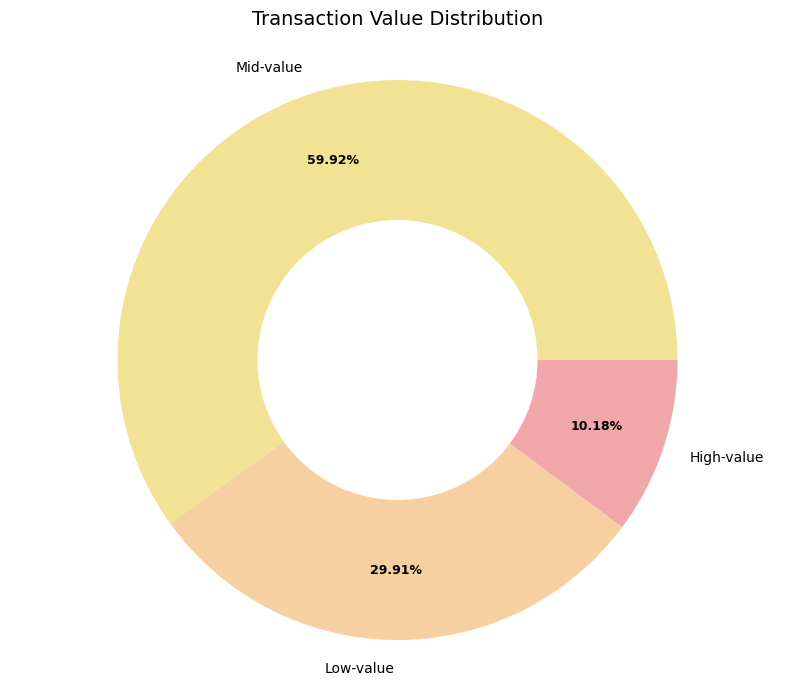

In [48]:
def plot_donut_jupyter(segment_dist):
    # Set style
    plt.style.use('bmh')
    
    # Create figure and axis
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # Custom colors
    colors = ['#f2e394', '#f7d0a1', '#f1a7a9']
    
    # Create donut chart
    wedges, texts, autotexts = ax.pie(segment_dist.values, 
                                     labels=segment_dist.index,
                                     colors=colors,
                                     autopct='%1.2f%%',
                                     pctdistance=0.75,
                                     wedgeprops=dict(width=0.5))
    
    # Add title
    plt.title('Transaction Value Distribution', pad=20, size=14)
    
    # Style the labels and percentages
    plt.setp(texts, size=10)
    plt.setp(autotexts, size=9, weight="bold")
    
    plt.axis('equal')
    return fig

# Use the function
fig = plot_donut_jupyter(segment_dist)

# Display the figure
fig.show()

1. **Distribusi Nilai Transaksi:**

a) **Mid-value (59.92%)**
- Rata-rata transaksi: Rp 109.489
- Median: Rp 99.99
- Jumlah transaksi: 61,263
- Jumlah order unik: 53,914
- Merupakan segmen terbesar dan paling stabil

b) **Low-value (29.91%)**
- Rata-rata transaksi: Rp 32.017
- Median: Rp 30.75
- Jumlah transaksi: 30,577
- Jumlah order unik: 29,189
- Mewakili hampir sepertiga dari total transaksi

c) **High-value (10.18%)**
- Rata-rata transaksi: Rp 258.608
- Median: Rp 250.00
- Jumlah transaksi: 10,407
- Jumlah order unik: 8,002
- Segmen premium dengan nilai tertinggi

2. **Implikasi untuk Strategi Pricing:**

a) **Strategi untuk Segmen Mid-value (59.92%):**
- Pertahankan sweet spot harga di sekitar Rp 99.99 (median)
- Implementasikan program bundling untuk mendorong pembelian di range Rp 100.000 - 150.000
- Buat program loyalitas dengan reward di sekitar nilai median untuk mendorong repeat purchase
- Fokus pada value proposition yang kuat untuk mempertahankan dominasi segmen ini

b) **Strategi untuk Segmen Low-value (29.91%):**
- Terapkan strategi "price anchoring" dengan menampilkan produk mid-value sebagai pembanding
- Buat paket bundling dengan harga psikologis (misal: Rp 49.99) untuk mendorong upgrade ke mid-value
- Berikan insentif pengiriman gratis untuk pembelian di atas Rp 50.000
- Fokus pada volume dan frekuensi pembelian untuk mengkompensasi margin yang lebih kecil

c) **Strategi untuk Segmen High-value (10.18%):**
- Kembangkan lini produk premium dengan margin yang lebih tinggi
- Tawarkan layanan eksklusif (priority shipping, customer service khusus)
- Implementasikan dynamic pricing untuk produk premium
- Buat program membership eksklusif dengan benefit khusus

3. **Rekomendasi Tambahan:**

a) **Optimalisasi Pricing:**
- Tetapkan harga psikologis di sekitar Rp 99.99 untuk produk mid-value
- Buat tier pricing yang jelas: < Rp 50.000, Rp 50.000-200.000, > Rp 200.000
- Implementasikan surge pricing pada periode peak demand

b) **Program Loyalitas:**
- Desain reward berdasarkan tier nilai transaksi
- Berikan insentif untuk upgrade ke tier yang lebih tinggi
- Buat milestone rewards untuk mendorong peningkatan nilai transaksi

c) **Strategi Promosi:**
- Sesuaikan jenis promosi dengan karakteristik setiap segmen
- Fokus pada upgrade value untuk segmen low-value
- Berikan exclusive early access untuk segmen high-value

## Conclusion

### **Conclution pertanyaan 1**
- Pelanggan yang sering bertransaksi dan memiliki pengeluaran besar memberikan kontribusi signifikan terhadap pendapatan dan harus dijaga melalui strategi harga premium dan program loyalitas.
- Pelanggan yang baru atau yang tidak lagi aktif harus diberi perhatian dengan pendekatan harga yang lebih menarik, seperti diskon atau tawaran khusus, untuk mendorong mereka melakukan pembelian lebih sering.
- Strategi pricing yang fleksibel dan berbasis pada segmentasi pelanggan sangat penting untuk memaksimalkan pendapatan dan mempertahankan pelanggan yang bernilai tinggi.

### **Conclution Pertanyaan 2**
- Fokus utama pada penguatan segmen mid-value sambil mendorong upgrading dari low-value
- Kembangkan strategi retensi khusus untuk segmen high-value
- Implementasikan differential pricing strategy berdasarkan segmen
- Gunakan data transaksi untuk personalisasi penawaran